# Accident Severity Prediction
This notebook is for Coursera Capstone porject to build an accident severity prediction model

In [1]:
import pandas as pd
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns
from pandas_profiling import ProfileReport

%matplotlib inline
%config InlineBackend.figure_format = 'retina'
mpl.rcParams['figure.dpi']= 150

In [2]:
print('Hello Capstone Project Course!')

Hello Capstone Project Course!


## 1 Introduction

### 1.1 Problem and background discussion

Accidents in traffic lead to associated fatalities and economic losses every year worldwide and thus is an area of primary concern to society from loss prevention point of view. Modeling accident severity prediction and improving the model are critical to the effective performance of road traffic systems for improved safety. In accident severity modeling, the input vectors are the characteristics of the accident, such as driver behavior and attributes of vehicle, highway and environment characteristics while the output vector is the corresponding class of accident severity.

There are two main engineering approaches for dealing with traffic safety problems: the reactive approach and the proactive approach. The reactive approach, or retrofit approach, consists of making the necessary improvements to variable, for instance, existing hazardous sites in order to reduce collision frequency and severity at these sites. The proactive approach, on the other hand, includes a collision prevention approach, like, preventing a potential unsafe road conditions from occurring in the first place. We focus on proactive approach which involves prediction of accident severity and working backwards, the concerned entity implements appropriate remedial measures to improve road safety. By recognizing the key factors that influence accident severity, the solution may be of great utility to various Government Departments/Authorities like Police, R&B and Transport from public policy point of view. The results of analysis and modeling can be used by these Departments to take appropriate measures to reduce accident impact and thereby improve traffic safety. It is also useful to the Insurers in terms of reduced claims and better underwriting as well as rate making.

### 1.2 Data description

The Collisions dataset of Seattle city is adopoted for this project, which inculdes all types of collisions provided by SPD and recorded by Traffic Records from 2004 to present (https://data.seattle.gov/Land-Base/Collisions/9kas-rb8d). A snapshot of data is shown below

In [3]:
df = pd.read_csv('./data/Collisions.csv')
df.head()

D:\tool\Anaconda3\lib\site-packages\IPython\core\interactiveshell.py:3058: DtypeWarning: Columns (35) have mixed types.Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


,X,Y,OBJECTID,INCKEY,COLDETKEY,REPORTNO,STATUS,ADDRTYPE,INTKEY,LOCATION,...,ROADCOND,LIGHTCOND,PEDROWNOTGRNT,SDOTCOLNUM,SPEEDING,ST_COLCODE,ST_COLDESC,SEGLANEKEY,CROSSWALKKEY,HITPARKEDCAR
0,1.268354e+06,265256.609668,1,1003,1003,3503158,Matched,Block,NaN,AURORA AVE N BETWEEN N 117TH PL AND N 125TH ST,...,Dry,Daylight,Y,NaN,NaN,45,Vehicle - Pedalcyclist,15057,0,N
1,1.259316e+06,202173.388163,2,56200,56200,1795087,Matched,Block,NaN,35TH AVE SW BETWEEN SW MORGAN ST AND SW HOLLY ST,...,Dry,Dark - Street Lights On,NaN,6015003.0,NaN,0,Vehicle going straight hits pedestrian,0,0,N
2,1.264342e+06,259613.000382,3,327037,328537,E979380,Matched,Intersection,37122.0,3RD AVE NW AND NW 100TH ST,...,Wet,Daylight,NaN,NaN,NaN,10,Entering at angle,0,0,N
3,1.279221e+06,222017.872023,4,327278,328778,E996362,Unmatched,Intersection,30602.0,M L KING JR WAY S AND S JACKSON ST,...,NaN,NaN,NaN,NaN,NaN,,NaN,0,0,N
4,1.262205e+06,242179.124204,5,1248,1248,3645424,Unmatched,Block,NaN,W EWING ST BETWEEN 6TH AVE W AND W EWING PL,...,NaN,NaN,NaN,NaN,NaN,,NaN,0,0,N


## 2 Methodology

### 2.1 Data cleaning

pandas_profiling is used to create a quick summary of all the variables. We can quickly examinate each of them to identify 1) if there is any abnormal with the data and 2) which of them are not useful for developing the model and hence can be dropped to create a slimmer dataset.

In [4]:
ProfileReport(df)

- <b>Derived variable:</b> Some variables are not appropriate to be directly used for modeling because there are too many distinct values, such as <b>X, Y, LOCATION, INCDATE and INCDTTM.</b> Here we derive the day of week from <b>INCDATE</b> and categorize <b>INCDTTM</b> into 4 groups 0:00\~5:59, 6:00\~11:59, 12:00\~17:59 and 18:00\~23:59. For the coordination X, Y and location, they could be useful variable since they contains the the geographic information about the incident. But more expert knowledge and techniques are required to apply to extract useful information and hence we leave them for now. 

In [5]:
# Derive the day of week (DOW)
df['INCDOW'] = pd.to_datetime(df.INCDATE).dt.dayofweek+1

# Derive the hour of day (HOD)
df['INCDH'] = pd.to_datetime(df.INCDTTM).dt.hour
df['INCDHOD'] = df['INCDH'].apply(lambda x: '0:00~5:59' if 0<=x<=5 else
                                            '6:00~11:59' if 6<=x<=11 else
                                            '12:00~17:59' if 12<=x<=17 else
                                            '18:00~23:59')

- <b>Target variable: SEVERITYCODE</b> is our target variable. As shown in the below reports, most of the accidents are with serverity code equal to 1(Property Damage Only Collision) or 2(Injury Collision), only a very few of cases fall into the category 2b(Serious Injury Collision) and 3(Fatality Collision), making the dataset unbalance in terms of the target variable. Also there are 21,616 records have 0 or unknown severity code which we need to remove them before developing the model. For later model developing purpose, we also re-map the serveritycode as follow:
1 - prop damage;
2 - injury;
3 - serious injury;
4 - fatality;

In [6]:
# Drop records with invalid value in target variables
df_2 = df.query("SEVERITYCODE.notnull().values and SEVERITYCODE!='0'").reset_index(drop=True)

# Re-map serveritycode
df_2['SEVERITYCODE'] = df_2['SEVERITYCODE'].replace('3','4')
df_2['SEVERITYCODE'] = df_2['SEVERITYCODE'].replace('2b','3')
df_2['SEVERITYCODE'] = df_2['SEVERITYCODE'].astype('int')

- <b>ID variable:</b> Some id variables do not provide much information for predicting the severity of the accident and hence can be dropped. Here we drop these variables: <b>REPORTNO, OBJECTID, COLDETKEY, INTKEY</b>. We keep the <b>INCKEY</b> as the unique identifier for the accidents.

- <b>Missing value:</b> Some variables are having high percentage of missing values and hence we may drop them as they don't provide enough information when we develop the model. Here we drop these variables: <b>EXCEPTRSNCODE, EXCEPTRSNDESC, INATTENTIONIND, PEDROWNOTGRNT, SDOTCOLNUM, SEGLANEKEY, CROSSWALKKEY, INJURIES, SERIOUSINJURIES, FATALITIES</b>. Note that <b>INJURIES, SERIOUSINJURIES, FATALITIES</b> are also have target leakage issue, so it will be wise to drop them from the dataset.

In [7]:
# Drop variables not used for model developments
df_2 = df_2.drop(columns=['X','Y','LOCATION','SEVERITYDESC', 'REPORTNO', 'OBJECTID', 'COLDETKEY', 'INTKEY',
                'EXCEPTRSNCODE', 'EXCEPTRSNDESC', 'INATTENTIONIND', 
                'PEDROWNOTGRNT', 'SDOTCOLNUM', 'SEGLANEKEY', 'CROSSWALKKEY',
                'INJURIES', 'SERIOUSINJURIES', 'FATALITIES',
                'INCDH','INCDATE','INCDTTM','ST_COLDESC','SDOT_COLDESC'])

# Take a look at remaining variables for model development
df_2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 199909 entries, 0 to 199908
Data columns (total 20 columns):
 #   Column         Non-Null Count   Dtype  
---  ------         --------------   -----  
 0   INCKEY         199909 non-null  int64  
 1   STATUS         199909 non-null  object 
 2   ADDRTYPE       197978 non-null  object 
 3   SEVERITYCODE   199909 non-null  int32  
 4   COLLISIONTYPE  195210 non-null  object 
 5   PERSONCOUNT    199909 non-null  int64  
 6   PEDCOUNT       199909 non-null  int64  
 7   PEDCYLCOUNT    199909 non-null  int64  
 8   VEHCOUNT       199909 non-null  int64  
 9   JUNCTIONTYPE   193528 non-null  object 
 10  SDOT_COLCODE   199909 non-null  float64
 11  UNDERINFL      195230 non-null  object 
 12  WEATHER        195019 non-null  object 
 13  ROADCOND       195100 non-null  object 
 14  LIGHTCOND      194930 non-null  object 
 15  SPEEDING       9928 non-null    object 
 16  ST_COLCODE     199891 non-null  object 
 17  HITPARKEDCAR   199909 non-nul

### 2.2 Exploratory Data Analysis

- <b>Categorical data:</b> below bar plots show the distribution of each categprical variables against the target variable. We can observe that most of the variables have very different distribution over different values of the target variable, which indicates, in general, the set of variables under selection as a whole have potential to consturct a good predictive model.

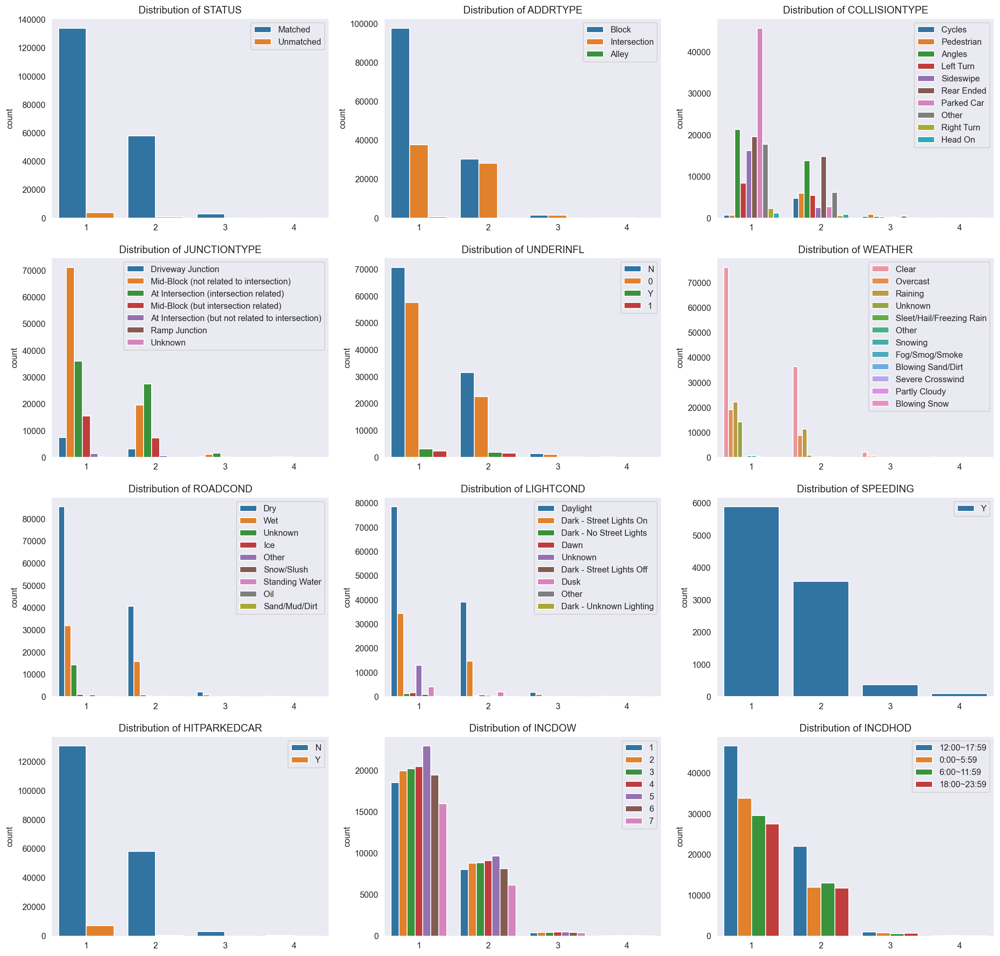

In [8]:
sns.set_style("dark")

fig = plt.figure(figsize=(20,20))
var_list = ['STATUS','ADDRTYPE','COLLISIONTYPE','JUNCTIONTYPE','UNDERINFL','WEATHER','ROADCOND',
            'LIGHTCOND','SPEEDING','HITPARKEDCAR','INCDOW','INCDHOD']

for i in range(len(var_list)):
    ax = fig.add_subplot(4, 3, i+1)
    var = var_list[i]
    sns.countplot(x='SEVERITYCODE', hue=var, data=df_2, ax = ax)
    ax.legend(loc='upper right')
    ax.set_title("Distribution of " + var)
    ax.xaxis.label.set_visible(False)

- <b>Numerical data:</b> below box plots show the distribution of each numerical variables against the target variable. We can observe that most of the variables have relatively similar distribution over different values of the target variable. At this stage we can not assert whether these variables are useful or not, as they can be indicative when combining with other variables. So we keep them for in the dataset and continue with the model development.

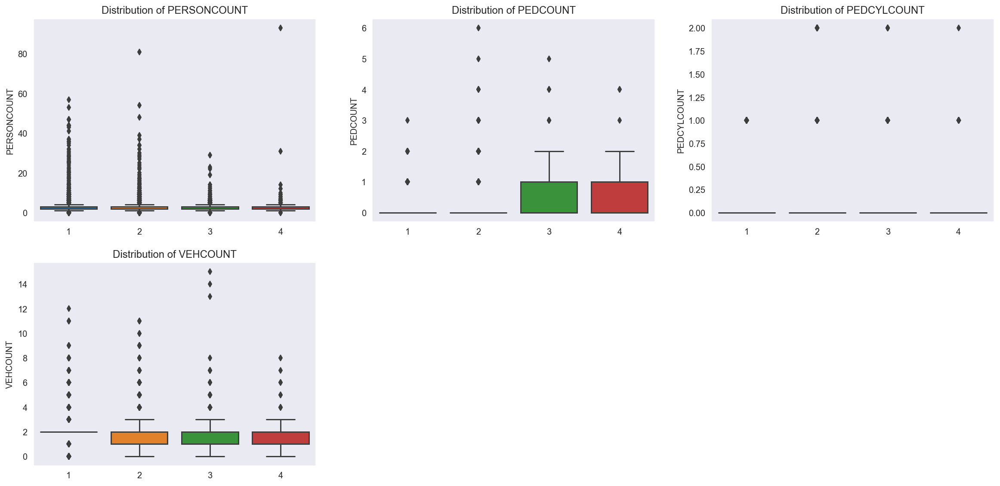

In [9]:
fig = plt.figure(figsize=(20,20))
var_list = ['PERSONCOUNT','PEDCOUNT','PEDCYLCOUNT','VEHCOUNT']

for i in range(len(var_list)):
    ax = fig.add_subplot(4, 3, i+1)
    var = var_list[i]
    sns.boxplot(x='SEVERITYCODE', y=var, data=df_2, ax = ax)
    ax.set_title("Distribution of " + var)
    ax.xaxis.label.set_visible(False)

### 2.3 Model development

In [10]:
from sklearn import preprocessing
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.naive_bayes import MultinomialNB
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.metrics import confusion_matrix

In [11]:
# Function to plot confusion matrix
def plot_confusion_matrix(y_test, y_preds):
    conf_mat = confusion_matrix(y_test, y_preds)
    #print(conf_mat)
    fig = plt.figure(figsize=(6,6))
    plt.matshow(conf_mat, cmap=plt.cm.Blues, fignum=1)
    plt.yticks(range(4))
    plt.xticks(range(4))
    plt.colorbar();
    for i in range(4):
        for j in range(4):
            plt.text(i-0.3,j+0.1, str(conf_mat[j, i]), color='tab:red', fontsize=12)
    plt.gca().xaxis.set_ticks_position('none') 

- <b>Data preprocessing:</b> before building the model, we perform one-hot encoding for the categorical variables and normalize the the numerical variables.

In [12]:
#### Categorical variables ####
cat_var = ['STATUS','ADDRTYPE','COLLISIONTYPE','JUNCTIONTYPE','UNDERINFL','WEATHER','ROADCOND',
            'LIGHTCOND','SPEEDING','HITPARKEDCAR','INCDOW','INCDHOD','SDOT_COLCODE','ST_COLCODE']

# Fix the data type to remove decimal for some codes
df_2['SDOT_COLCODE'] = df_2['SDOT_COLCODE'].astype('int')
df_2['ST_COLCODE'] = df_2['ST_COLCODE'].fillna('0')
df_2['ST_COLCODE'] = df_2['ST_COLCODE'].replace(to_replace=[' '], value = '0')
df_2['ST_COLCODE'] = df_2['ST_COLCODE'].astype('int')

# One-hot encoding
df_3 = pd.get_dummies(df_2, columns=cat_var)

#### Numerical variables ####
num_var = ['PERSONCOUNT','PEDCOUNT','PEDCYLCOUNT','VEHCOUNT']

# Min Max normalization
df_num = df_3[num_var].values
min_max_scaler = preprocessing.MinMaxScaler()
df_scaled = min_max_scaler.fit_transform(df_num)
df_scaled = pd.DataFrame(df_scaled)
df_scaled.columns = num_var

# Final dataset
df_4 = df_scaled.combine_first(df_3)

- Split the data set into training and testing data

In [13]:
train, test = train_test_split(df_4, test_size=0.2)

x_train = train.drop(columns=['SEVERITYCODE','INCKEY']).values
y_train = train['SEVERITYCODE'].values

x_test = test.drop(columns=['SEVERITYCODE','INCKEY']).values
y_test = test['SEVERITYCODE'].values

- <b>Multinomial Naive Bayes model</b>

Fitting 5 folds for each of 5 candidates, totalling 25 fits


[Parallel(n_jobs=3)]: Using backend LokyBackend with 3 concurrent workers.
[Parallel(n_jobs=3)]: Done  12 tasks      | elapsed:    5.7s
[Parallel(n_jobs=3)]: Done  25 out of  25 | elapsed:   10.6s finished


Train Accuracy : 0.679
Test Accuracy : 0.678
Best Accuracy Through Grid Search : 0.679
Best Parameters :  {'alpha': 10.0}


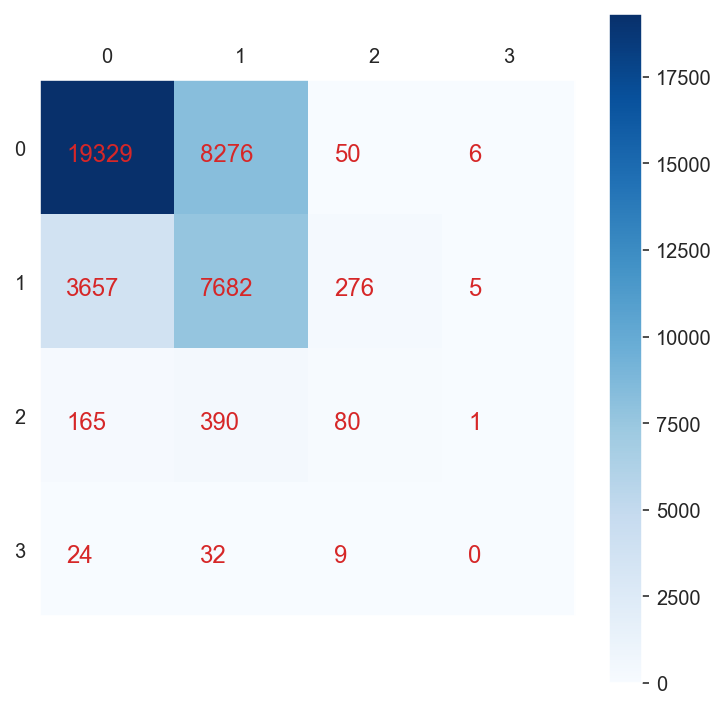

In [14]:
params = {'alpha': [0.01, 0.1, 0.5, 1.0, 10.0]}

multinomial_nb_grid = GridSearchCV(MultinomialNB(), param_grid=params, n_jobs=3, cv=5, verbose=5)
multinomial_nb_grid.fit(x_train,y_train)

print('Train Accuracy : %.3f'%multinomial_nb_grid.best_estimator_.score(x_train, y_train))
print('Test Accuracy : %.3f'%multinomial_nb_grid.best_estimator_.score(x_test, y_test))
print('Best Accuracy Through Grid Search : %.3f'%multinomial_nb_grid.best_score_)
print('Best Parameters : ',multinomial_nb_grid.best_params_)

plot_confusion_matrix(y_test, multinomial_nb_grid.best_estimator_.predict(x_test))

- <b>Support vector meachine model</b>

Fitting 5 folds for each of 3 candidates, totalling 15 fits


[Parallel(n_jobs=3)]: Using backend LokyBackend with 3 concurrent workers.
[Parallel(n_jobs=3)]: Done  15 out of  15 | elapsed: 740.6min finished
D:\tool\Anaconda3\lib\site-packages\sklearn\svm\base.py:193: FutureWarning: The default value of gamma will change from 'auto' to 'scale' in version 0.22 to account better for unscaled features. Set gamma explicitly to 'auto' or 'scale' to avoid this warning.
  "avoid this warning.", FutureWarning)


Train Accuracy : 0.738
Test Accuracy : 0.743
Best Accuracy Through Grid Search : 0.738
Best Parameters :  {'C': 1, 'kernel': 'sigmoid'}


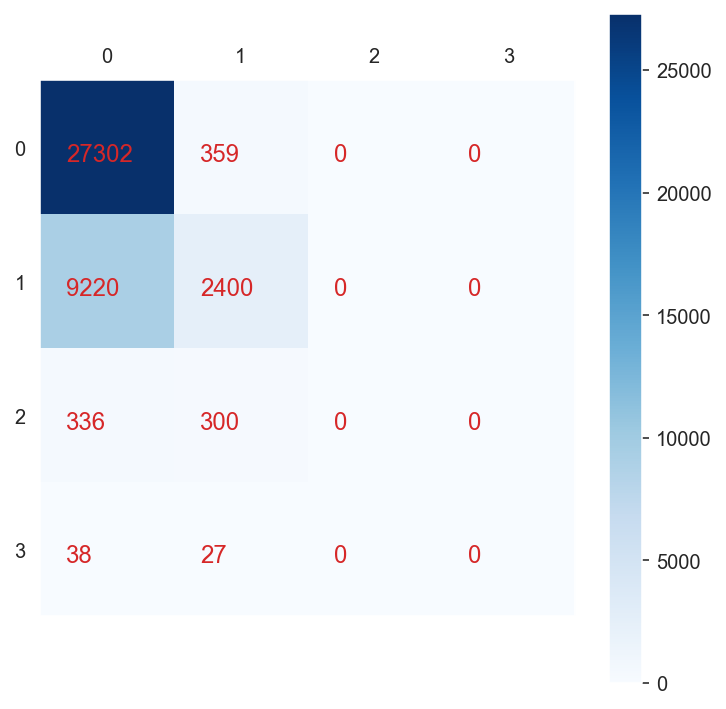

In [16]:
params = {'C' : [0.1,1,10], 'kernel': ['sigmoid']}

svm_grid = GridSearchCV(SVC(), param_grid=params, n_jobs=3, cv=5, verbose=5)
svm_grid.fit(x_train,y_train)

print('Train Accuracy : %.3f'%svm_grid.best_estimator_.score(x_train, y_train))
print('Test Accuracy : %.3f'%svm_grid.best_estimator_.score(x_test, y_test))
print('Best Accuracy Through Grid Search : %.3f'%svm_grid.best_score_)
print('Best Parameters : ',svm_grid.best_params_)

plot_confusion_matrix(y_test, svm_grid.best_estimator_.predict(x_test))

- <b>Logistic regression model</b>

Fitting 5 folds for each of 6 candidates, totalling 30 fits


[Parallel(n_jobs=3)]: Using backend LokyBackend with 3 concurrent workers.
[Parallel(n_jobs=3)]: Done  12 tasks      | elapsed:  9.2min
[Parallel(n_jobs=3)]: Done  30 out of  30 | elapsed: 30.8min finished
D:\tool\Anaconda3\lib\site-packages\sklearn\linear_model\logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
D:\tool\Anaconda3\lib\site-packages\sklearn\linear_model\logistic.py:469: FutureWarning: Default multi_class will be changed to 'auto' in 0.22. Specify the multi_class option to silence this warning.
  "this warning.", FutureWarning)


Train Accuracy : 0.747
Test Accuracy : 0.751
Best Accuracy Through Grid Search : 0.746
Best Parameters :  {'C': 10, 'penalty': 'l1'}


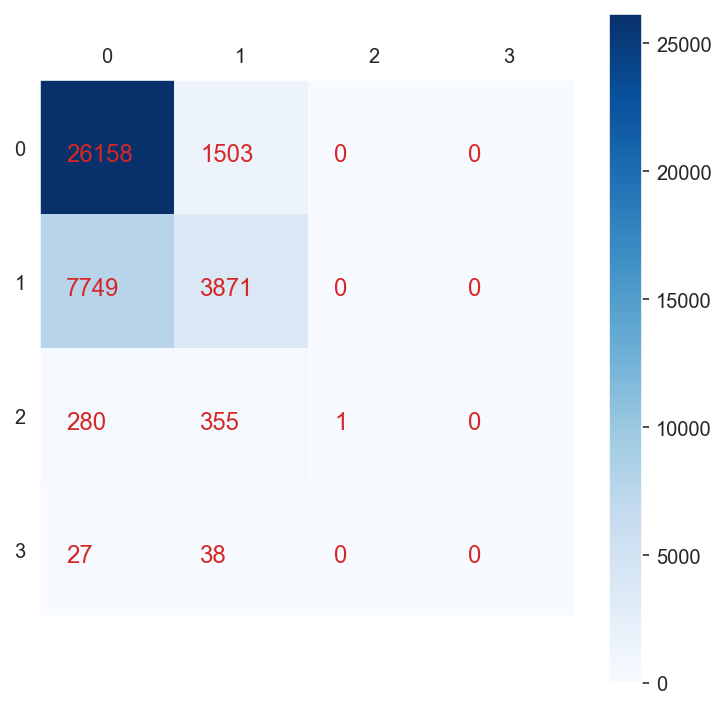

In [15]:
params = {'penalty' : ['l1', 'l2'], 'C' : [0.1,1,10]}

lr_grid = GridSearchCV(LogisticRegression(), param_grid=params, n_jobs=3, cv=5, verbose=5)
lr_grid.fit(x_train,y_train)

print('Train Accuracy : %.3f'%lr_grid.best_estimator_.score(x_train, y_train))
print('Test Accuracy : %.3f'%lr_grid.best_estimator_.score(x_test, y_test))
print('Best Accuracy Through Grid Search : %.3f'%lr_grid.best_score_)
print('Best Parameters : ',lr_grid.best_params_)

plot_confusion_matrix(y_test, lr_grid.best_estimator_.predict(x_test))

## 3 Results & Discussion

As shown above, we have developed 3 models, Multinomial Naive Bayes, Support vector meachine and Logistic regression, to predict the accident severity. The testing results showing that logistic regression has the best accuracy among the 3 models.

We notice that for all these 3 models, most of the prediction concentrate on predicting the severity to be Property Damage followed by Injury, while less predictions were given to serious injury and fatality, which may relate to the imbalance data set we have on hand and we need to take care of this issue to further improvde the model accuracy in the future.